# Import all the libraries

In [1]:
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import time
import torch
import torchvision.models as models
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from torchvision.utils import make_grid
import matplotlib.cm as cm
from sklearn.metrics import silhouette_samples, silhouette_score

# Load all the processed images by batches

In [2]:
class ProcessedImageDataset(Dataset):
    def __init__(self, folder):
        self.folder = folder
        self.tensor_files = [f for f in os.listdir(folder) if f.endswith('.pt')]

    def __len__(self):
        return len(self.tensor_files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.folder, self.tensor_files[idx])
        image = torch.load(file_path)
        image = (image + 1) / 2  # Unnormalize from [-1, 1] to [0, 1]
        
        normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                         std=[0.229, 0.224, 0.225])
        image = normalize(image)
        return image, self.tensor_files[idx]  # return filename too (optional)

In [3]:
dataset = ProcessedImageDataset("../data/processed/")
dataloader = DataLoader(dataset, batch_size=64, shuffle=False)  # tweak batch size

# Feature extraction from the images using transfer learning

In [4]:
resnet = models.resnet18(pretrained=True)
resnet.fc = torch.nn.Identity()
resnet.eval()

features_list = []
filenames = []

with torch.no_grad():
    for batch, names in dataloader:
        batch_features = resnet(batch)  # Shape: [B, 512]
        features_list.append(batch_features)
        filenames.extend(names)

features = torch.cat(features_list)  # Shape: [N, 512]

/usr/lib/python3.13/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/lib/python3.13/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [5]:
features.shape

torch.Size([7228, 512])

In [6]:
# save the basic features
torch.save(features, "../models/features_basic.pt")

In [7]:
# load the features
features_basic = torch.load("../models/features_basic.pt")

In [8]:
features_basic.shape

torch.Size([7228, 512])

Now we have 512 features for each images.

# Principal Component Analysis

In [9]:
pca = PCA(n_components=2)
features_reduced_pca = pca.fit_transform(features_basic)

In [10]:
features_reduced_pca

array([[-2.45533257, -7.26478707],
       [-3.1057836 , -2.64354277],
       [ 7.40625377, -0.88271402],
       ...,
       [10.44751617, -0.84738578],
       [-3.65878772, -7.06690623],
       [-5.2486515 , -2.17662778]], shape=(7228, 2))

In [11]:
x = []
y = []
for i in range(len(features_reduced_pca)):
    x.append(features_reduced_pca[i][0])
    y.append(features_reduced_pca[i][1])

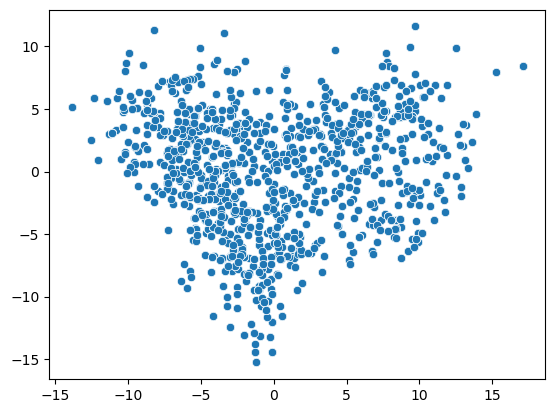

In [12]:
sns.scatterplot(x=x, y=y)
plt.show()

# Basic model training: K-means clustering

In [30]:
inertias = [] # for elbow plot
silhouette_scores = [] # for silhouette score
features_basic_np = features_basic.numpy()
cluster_range = range(2, 50)  # You can change the upper limit

for k in cluster_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(features_basic)

    cluster_labels = kmeans.fit_predict(features_basic_np)
    inertias.append(kmeans.inertia_)
    score = silhouette_score(features_basic_np, cluster_labels)
    
    silhouette_scores.append(score)
    print(f"Silhouette score for k={k}: {score:.4f}")

Silhouette score for k=2: 0.0710
Silhouette score for k=3: 0.0681
Silhouette score for k=4: 0.0533
Silhouette score for k=5: 0.0533
Silhouette score for k=6: 0.0587
Silhouette score for k=7: 0.0576
Silhouette score for k=8: 0.0633
Silhouette score for k=9: 0.0651
Silhouette score for k=10: 0.0653
Silhouette score for k=11: 0.0634
Silhouette score for k=12: 0.0614
Silhouette score for k=13: 0.0591
Silhouette score for k=14: 0.0627
Silhouette score for k=15: 0.0646
Silhouette score for k=16: 0.0689
Silhouette score for k=17: 0.0684
Silhouette score for k=18: 0.0710
Silhouette score for k=19: 0.0688
Silhouette score for k=20: 0.0683
Silhouette score for k=21: 0.0775
Silhouette score for k=22: 0.0769
Silhouette score for k=23: 0.0760
Silhouette score for k=24: 0.0744
Silhouette score for k=25: 0.0726
Silhouette score for k=26: 0.0743
Silhouette score for k=27: 0.0762
Silhouette score for k=28: 0.0779
Silhouette score for k=29: 0.0752
Silhouette score for k=30: 0.0751
Silhouette score for k

### Elbow plot

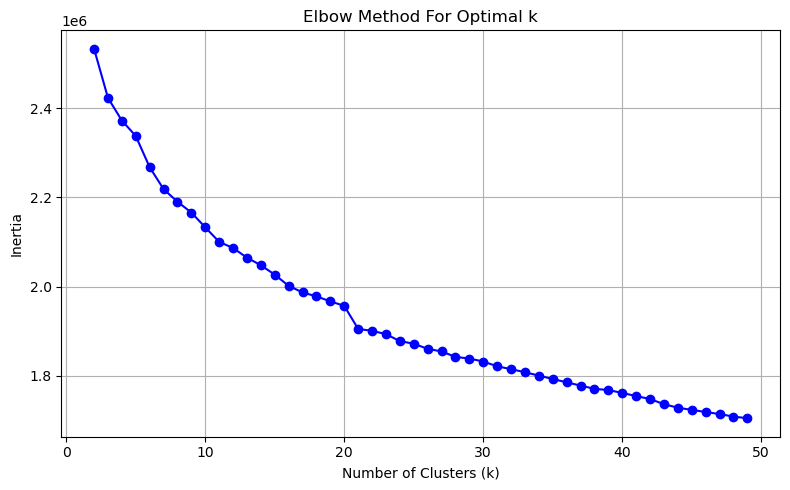

In [31]:
# Plot the elbow curve
plt.figure(figsize=(8, 5))
plt.plot(cluster_range, inertias, 'bo-')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia")
plt.title("Elbow Method For Optimal k")
plt.grid(True)
plt.tight_layout()
plt.show()

## Silhoutte score

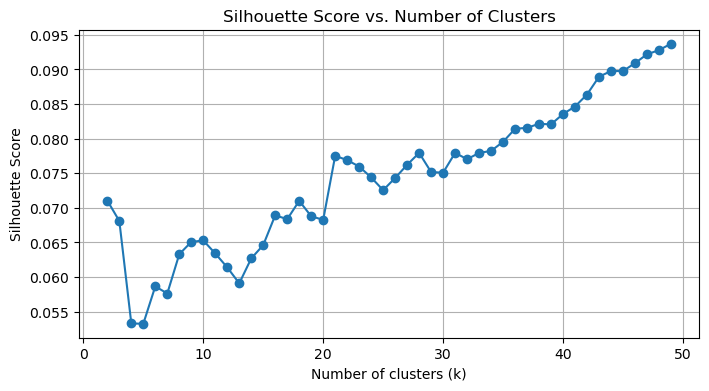

In [32]:
plt.figure(figsize=(8, 4))
plt.plot(cluster_range, silhouette_scores, marker='o')
plt.title('Silhouette Score vs. Number of Clusters')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette Score')
plt.grid(True)
plt.show()

- The silhouette coefficient are very close to 0. So we can't say much about the distribution of the clusters. 

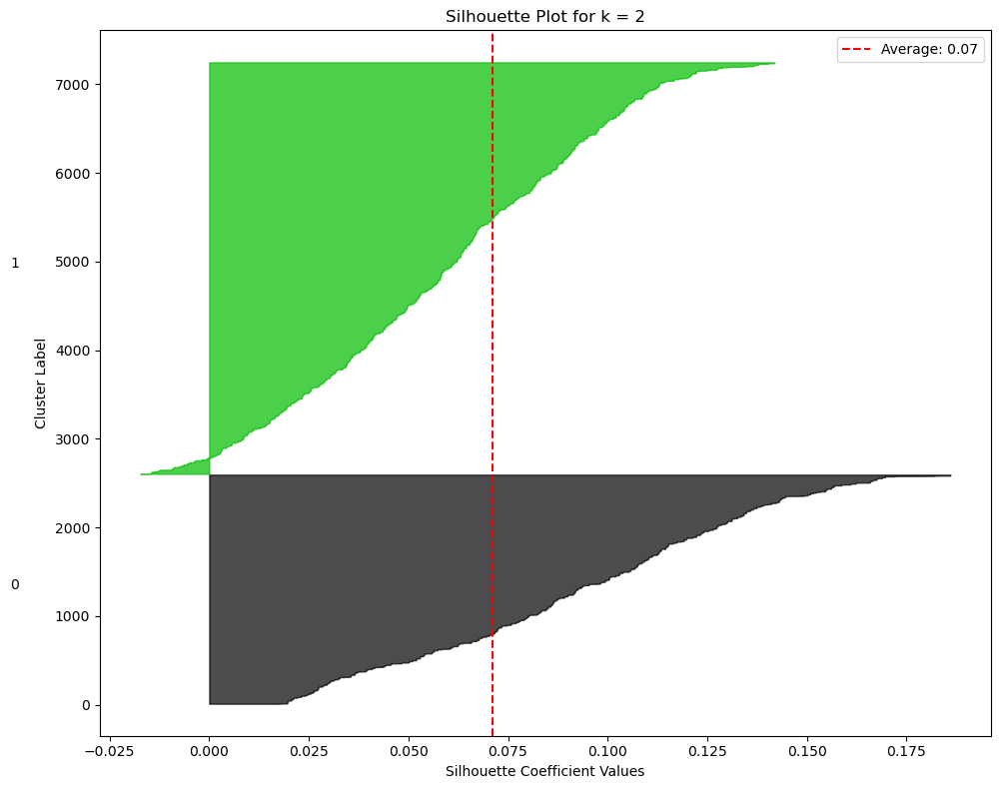

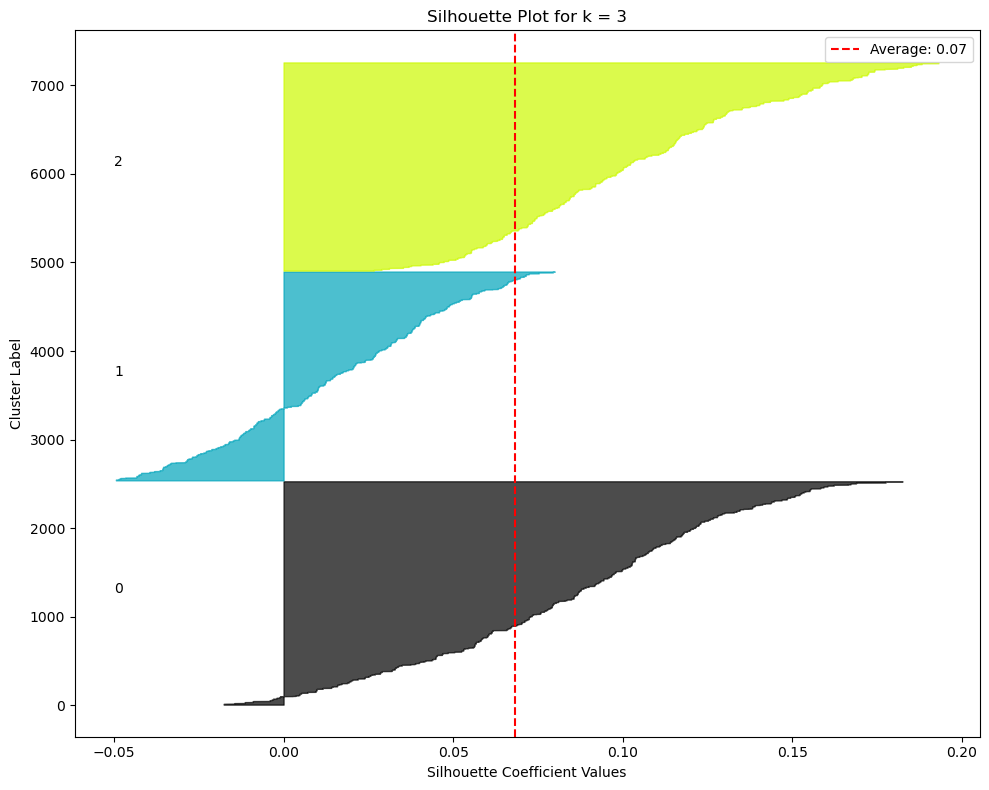

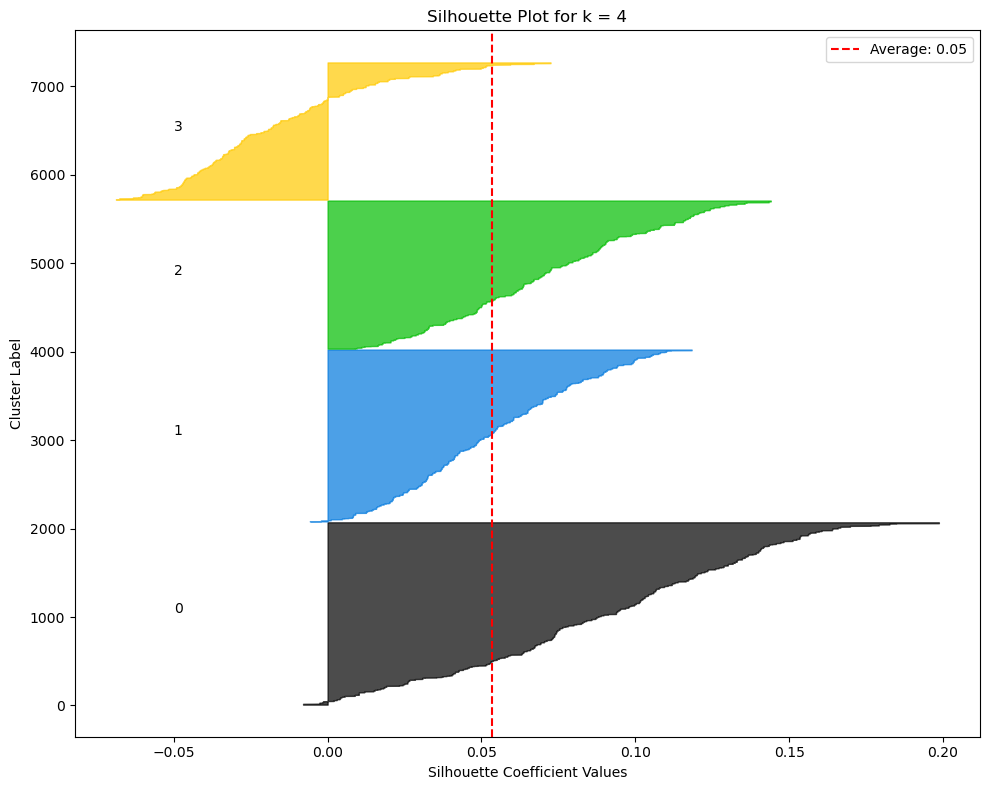

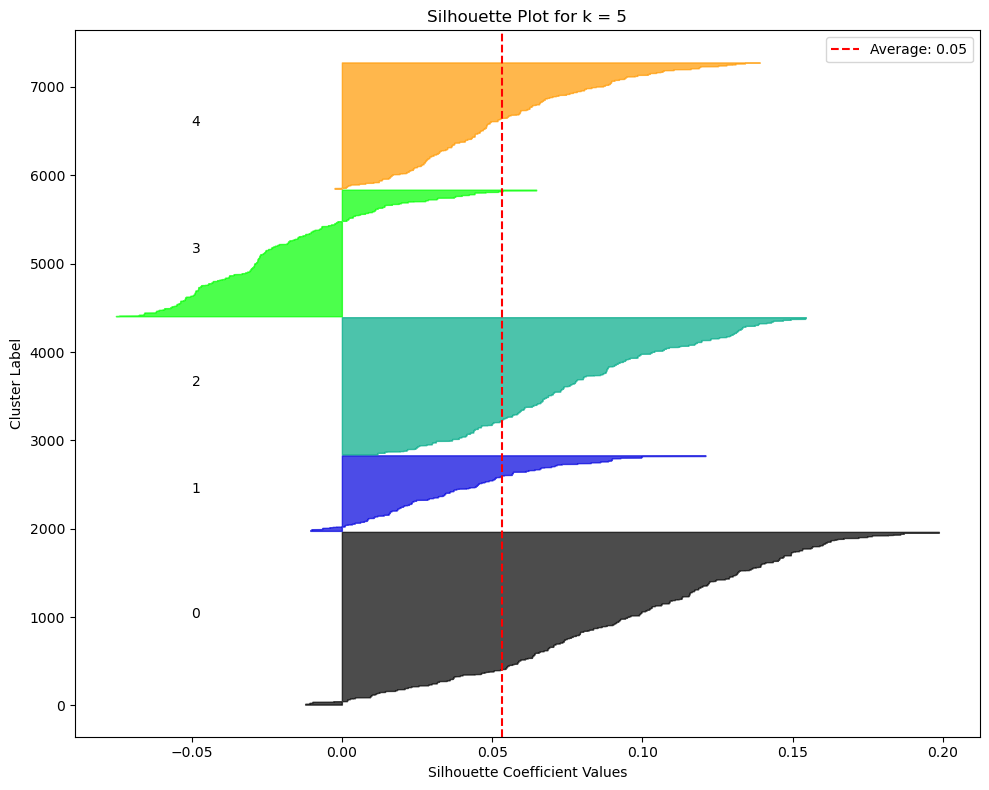

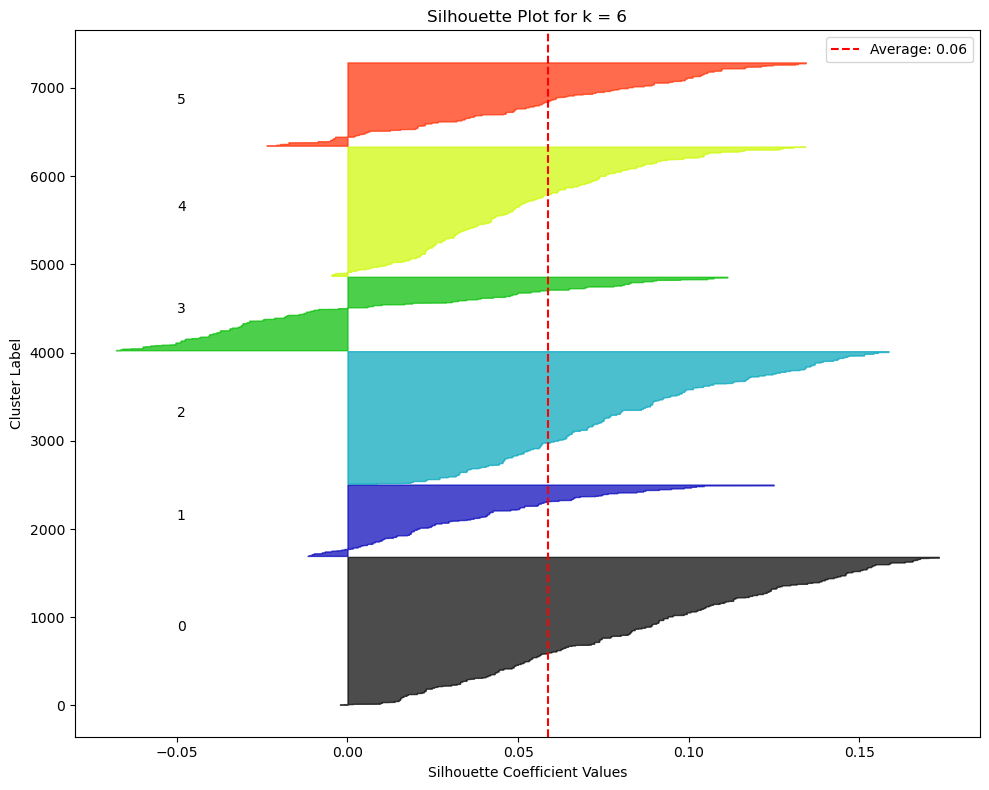

...

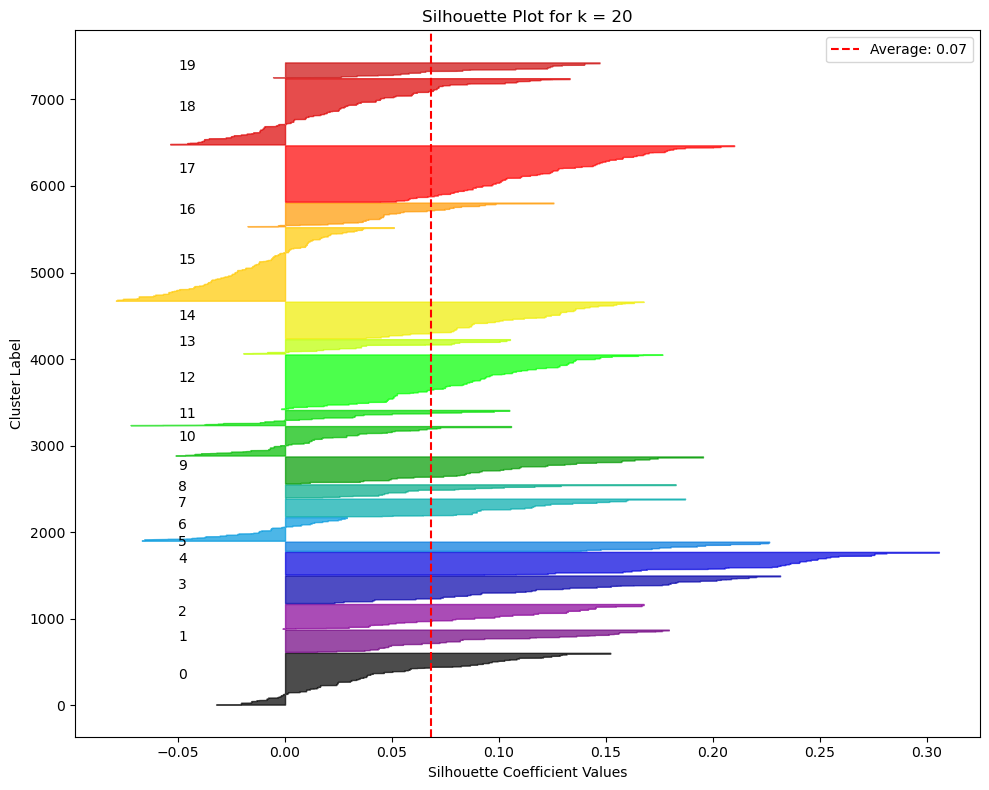

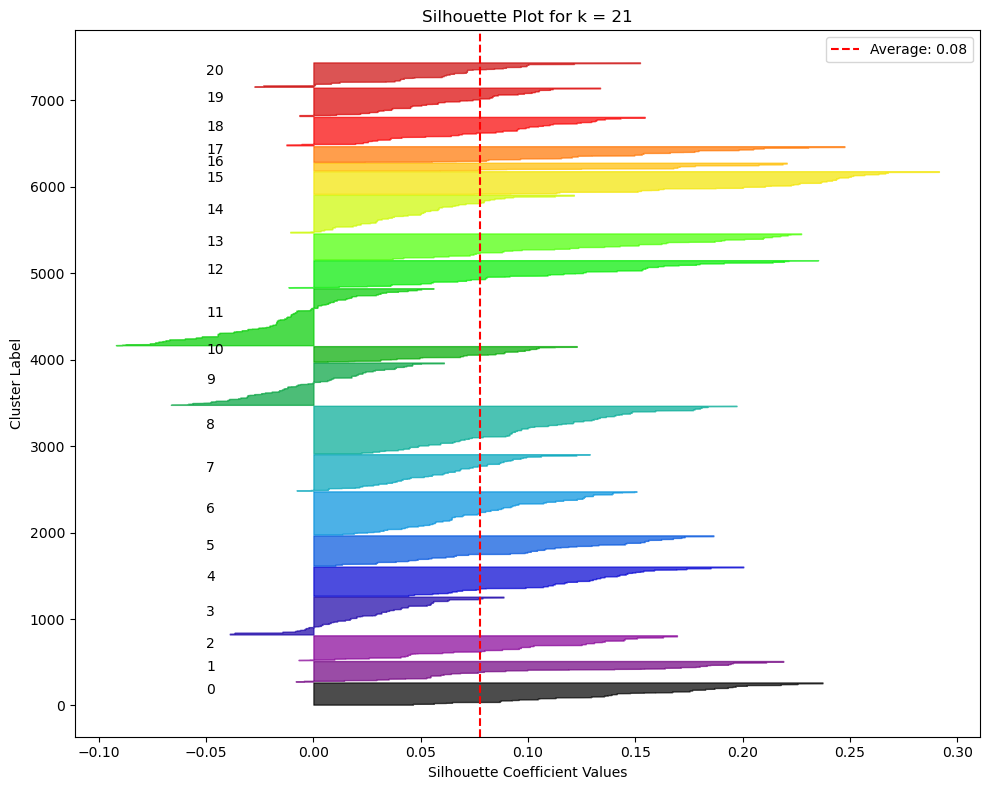

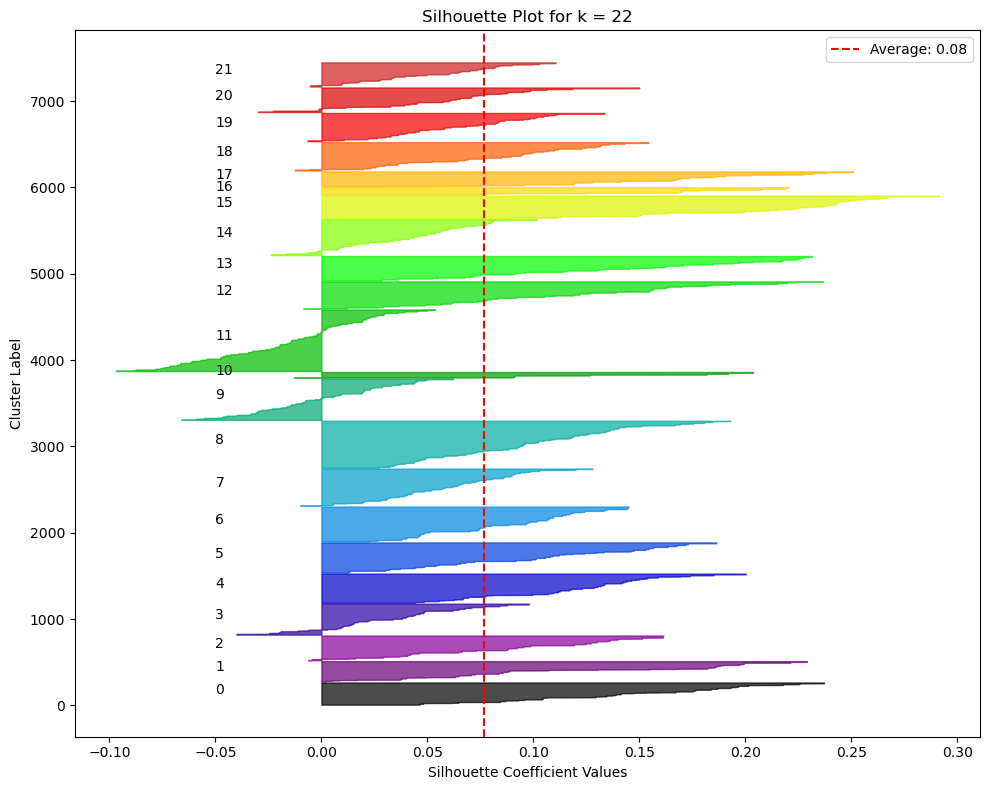

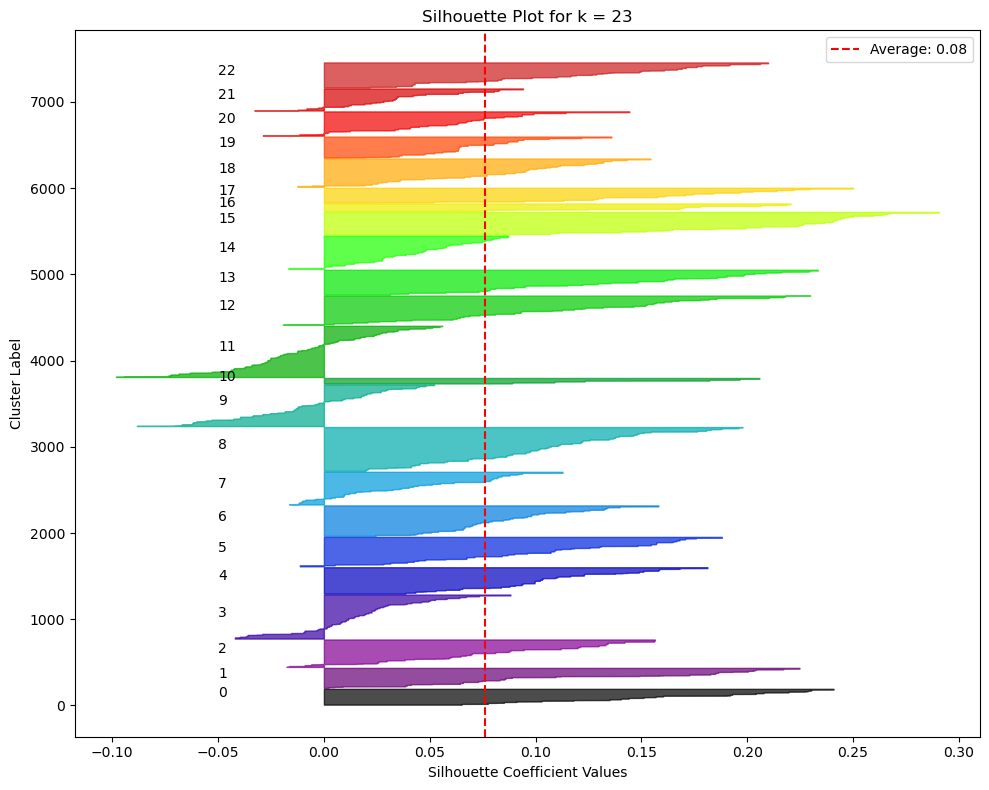

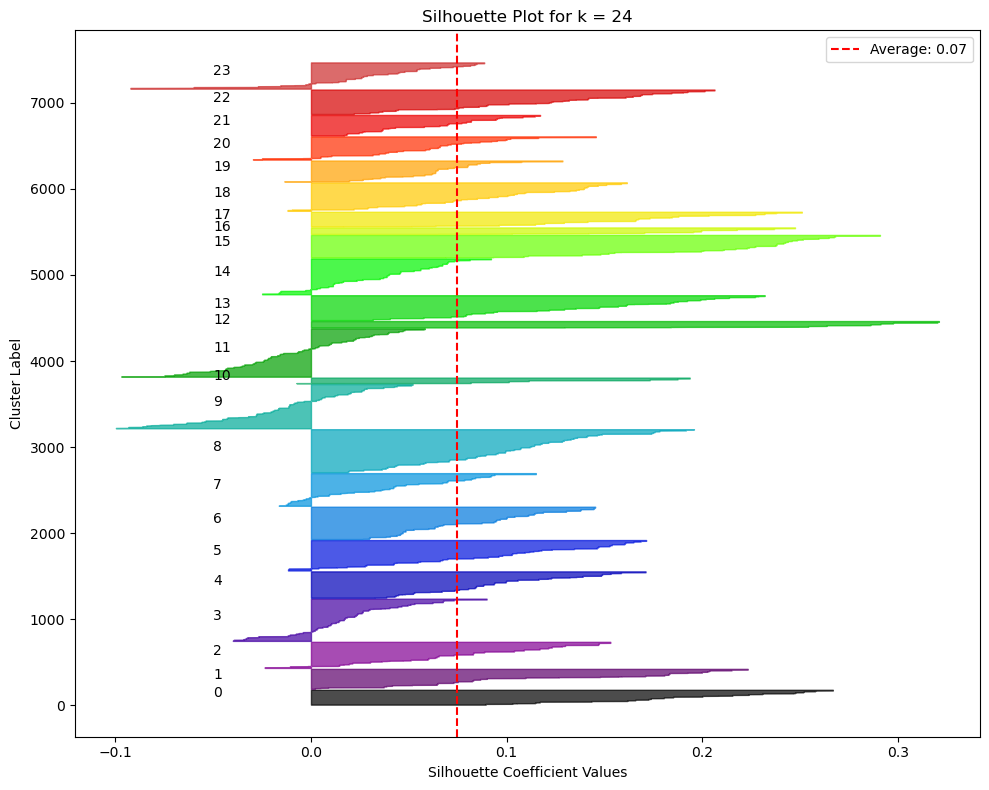

In [36]:
k_values = range(2, 25)  # You can adjust this range

for n_clusters in k_values:
    # Perform KMeans clustering
    kmeans_s = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels_s = kmeans_s.fit_predict(features_basic_np)

    # Compute silhouette scores
    silhouette_avg = silhouette_score(features_basic_np, cluster_labels_s)
    sample_silhouette_values = silhouette_samples(features_basic_np, cluster_labels_s)

    # Create figure
    fig, ax = plt.subplots(figsize=(10, 8))
    y_lower = 10

    for i in range(n_clusters):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels_s == i]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax.fill_betweenx(np.arange(y_lower, y_upper),
                         0, ith_cluster_silhouette_values,
                         facecolor=color, edgecolor=color, alpha=0.7)

        ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10

    ax.axvline(x=silhouette_avg, color="red", linestyle="--", label=f"Average: {silhouette_avg:.2f}")
    ax.set_title(f"Silhouette Plot for k = {n_clusters}")
    ax.set_xlabel("Silhouette Coefficient Values")
    ax.set_ylabel("Cluster Label")
    ax.legend()
    ax.grid(False)

    plt.tight_layout()
    plt.show()


For a basic model, 21 clusters would be good. But to be more sure, calculate the Silhoutte score.

In [37]:
kmeans_basic = KMeans(n_clusters=21, random_state=42)
cluster_labels_basic = kmeans_basic.fit_predict(features_basic)

In [38]:
import pandas as pd

df = pd.DataFrame({
    "filename": filenames,
    "cluster": cluster_labels_basic
})
df.to_csv("../data/labels/cluster_results_basic.csv", index=False)

In [39]:
len(df.cluster.value_counts())

21

In [40]:
df

,filename,cluster
0,tc2az9x7.pt,1
1,7tdmueel.pt,3
2,j9fit435.pt,9
3,we9ti72w.pt,7
4,0hos3gsw.pt,19
...,...,...
7223,ls6kwdu1.pt,14
7224,egjfzl43.pt,14
7225,mq1vvqsg.pt,5
7226,5cdp3ut3.pt,1


In [42]:
df["cluster"].value_counts().sort_index()

cluster
0     257
1     238
2     287
3     437
4     338
5     351
6     499
7     420
8     550
9     490
10    180
11    659
12    315
13    299
14    437
15    263
16     88
17    181
18    329
19    328
20    282
Name: count, dtype: int64

In [43]:
# Load the CSV
df = pd.read_csv("../data/labels/cluster_results_basic.csv")

# Define the path to processed image tensors
processed_folder = "../data/processed/"  # change this if needed

def show_cluster(df, cluster_id, num_images=16):
    # Filter filenames belonging to the selected cluster
    files = df[df['cluster'] == cluster_id]['filename'].values[:num_images]

    # Load the tensors and stack
    images = [torch.load(os.path.join(processed_folder, f)).unsqueeze(0) for f in files]
    images = torch.cat(images)

    # Denormalize from [-1, 1] to [0, 1] for display
    images = (images + 1) / 2

    # Create a grid and show
    grid = make_grid(images, nrow=10, padding=2)
    plt.figure(figsize=(40, 60))
    plt.imshow(grid.permute(1, 2, 0).numpy())
    plt.axis("off")
    plt.title(f"Cluster {cluster_id}")
    plt.show()

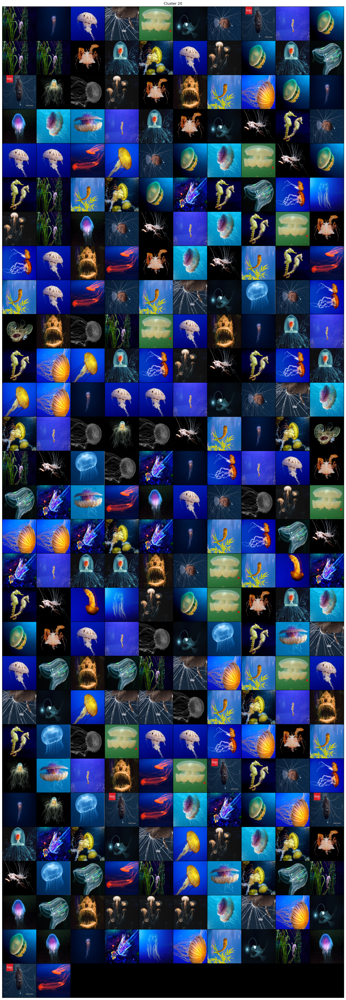

In [69]:
# Visualize clusters 0 to 4
i = 20
show_cluster(df, cluster_id=i, num_images=282)

## Label good clusters and save them into the `data/clustered_images` folder

In [74]:
turtle = df[df["cluster"] == 0]

In [77]:
shark = df[df["cluster"] == 4]

In [78]:
dolphine_whale = df[df["cluster"] == 5]

In [79]:
rays = df[df["cluster"] == 7]

In [80]:
corals = df[df["cluster"] == 8]

In [81]:
lobster_crab = df[df["cluster"] == 12]

In [82]:
starfish_octopus = df[df["cluster"] == 13]

In [83]:
some_fish = df[df["cluster"] == 15]

In [84]:
seal_a = df[df["cluster"] == 16]

In [85]:
nemo = df[df["cluster"] == 17]

In [86]:
seal_b = df[df["cluster"] == 18]

In [87]:
seal_a

,filename,cluster
51,m9k7jhtf.pt,16
411,7zh96uka.pt,16
543,r2u96pnd.pt,16
593,67cemqrp.pt,16
736,ut2rytzx.pt,16
...,...,...
6703,196hc82z.pt,16
6717,jlsm2yb1.pt,16
6727,6qpibj0e.pt,16
6893,lfdfuoji.pt,16


In [88]:
seal_b

,filename,cluster
19,em5nlj8v.pt,18
22,waay0dnh.pt,18
28,z184gpbn.pt,18
39,ff2aqqna.pt,18
42,6zwgggfj.pt,18
...,...,...
7106,1e1yi6q4.pt,18
7117,drtuc3kb.pt,18
7171,6j5220va.pt,18
7204,81k6974g.pt,18


In [91]:
seal = pd.concat([seal_a, seal_b])

In [92]:
seal

,filename,cluster
51,m9k7jhtf.pt,16
411,7zh96uka.pt,16
543,r2u96pnd.pt,16
593,67cemqrp.pt,16
736,ut2rytzx.pt,16
...,...,...
7106,1e1yi6q4.pt,18
7117,drtuc3kb.pt,18
7171,6j5220va.pt,18
7204,81k6974g.pt,18


In [103]:
good_clusters = [
    turtle,
    shark,
    dolphine_whale,
    rays,
    corals,
    lobster_crab,
    starfish_octopus,
    some_fish,
    seal,
    nemo
]

good_clusters_name = [
    "turtle",
    "shark",
    "dolphine_whale",
    "rays",
    "corals",
    "lobster_crab",
    "starfish_octopus",
    "some_fish",
    "seal",
    "nemo"
]

In [129]:
input_dir = "../data/processed/"
root_dir = "../data/clustered_images/"

for i in range(len(good_clusters)):
    # create the output directory
    tmp = os.path.join(root_dir, good_clusters_name[i])
    os.makedirs(tmp, exist_ok=True)

    animal_df = good_clusters[i]
    for file_name in animal_df["filename"]:
        source_file = os.path.join(input_dir, file_name)
        destination_file = os.path.join(tmp, file_name)
        shutil.copy(source_file, destination_file)

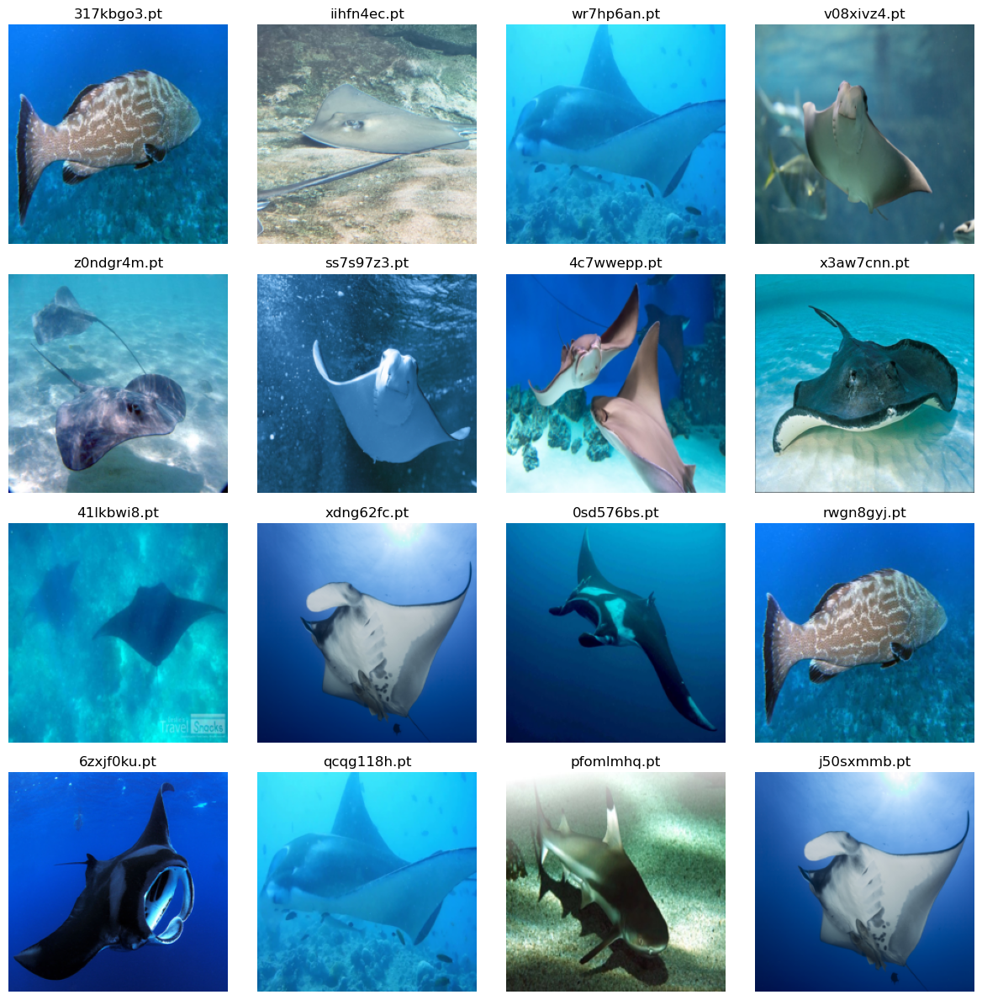

In [151]:
import random
# Folder with .pt files
tensor_folder = "../data/clustered_images/rays"

# List all .pt files
all_tensors = [f for f in os.listdir(tensor_folder) if f.endswith('.pt')]

# Randomly select 16
sample_tensors = random.sample(all_tensors, 16)

# Plot settings
plt.figure(figsize=(12, 12))

for i, tensor_file in enumerate(sample_tensors):
    tensor_path = os.path.join(tensor_folder, tensor_file)
    
    # Load the tensor
    img_tensor = torch.load(tensor_path)

    # If normalized ([-1, 1]), unnormalize to [0, 1]
    img_tensor = img_tensor * 0.5 + 0.5

    # Convert to NumPy and permute to HWC
    img_np = img_tensor.permute(1, 2, 0).numpy()

    # Plot
    plt.subplot(4, 4, i + 1)
    plt.imshow(img_np)
    plt.title(os.path.basename(tensor_file), fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.show()

## Drop those good cluster from df to get the bad clusters together

In [136]:
df

,filename,cluster
0,tc2az9x7.pt,1
1,7tdmueel.pt,3
2,j9fit435.pt,9
3,we9ti72w.pt,7
4,0hos3gsw.pt,19
...,...,...
7223,ls6kwdu1.pt,14
7224,egjfzl43.pt,14
7225,mq1vvqsg.pt,5
7226,5cdp3ut3.pt,1


In [144]:
df_bad = df[(df["cluster"] == 1) | 
(df["cluster"] == 2) |
(df["cluster"] == 3) |
(df["cluster"] == 6) |
(df["cluster"] == 9) |
(df["cluster"] == 10) |
(df["cluster"] == 11) |
(df["cluster"] == 14) |
(df["cluster"] == 19) |
(df["cluster"] == 20)]

In [145]:
df_bad.shape

(3837, 2)

In [146]:
df.shape

(7228, 2)

In [148]:
(df_bad.shape[0] / df.shape[0]) * 100

53.0852241283896

**Comments**
- Just by using a basic model, I am able to cluster 53% of the images properly.

**Next step**
- Now again use Resnet18 and K-means clustering to cluster the bad clusters properly.

In [152]:
# save all the images from the bad clusters to a different folder
# then call from there as the functions are already written before
input_dir_bad = "../data/processed/"
output_dir = "../data/bad_clustered_images/"

for file_name in df_bad["filename"]:
    source_file_bad = os.path.join(input_dir_bad, file_name)
    destination_file_bad = os.path.join(output_dir, file_name)
    shutil.copy(source_file_bad, destination_file_bad)

## Load all the bad clustered images by batches

In [154]:
dataset_2 = ProcessedImageDataset(output_dir)
dataloader_2 = DataLoader(dataset_2, batch_size=64, shuffle=False)

## Feature extraction from the images using transfer learning

In [160]:
resnet_2 = models.resnet50(pretrained=True)
resnet_2.fc = torch.nn.Identity()
resnet_2.eval()

features_list_2 = []
filenames_2 = []

with torch.no_grad():
    for batch, names in dataloader_2:
        batch_features_2 = resnet_2(batch)  # Shape: [B, 512]
        features_list_2.append(batch_features_2)
        filenames_2.extend(names)

features_2 = torch.cat(features_list_2)  # Shape: [N, 512]

/usr/lib/python3.13/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/lib/python3.13/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /home/abhishek/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:16<00:00, 6.31MB/s]


In [161]:
features_2.shape

torch.Size([3837, 2048])

In [162]:
torch.save(features_2, "../models/features_2.pt")

In [163]:
inertias_2 = [] # for elbow plot
silhouette_scores_2 = [] # for silhouette score
features_2_np = features_2.numpy()
cluster_range_2 = range(2, 20)  # You can change the upper limit

for k in cluster_range_2:
    kmeans_2 = KMeans(n_clusters=k, random_state=42)
    kmeans_2.fit(features_2)

    cluster_labels_2 = kmeans_2.fit_predict(features_2_np)
    inertias_2.append(kmeans_2.inertia_)
    score_2 = silhouette_score(features_2_np, cluster_labels_2)
    
    silhouette_scores_2.append(score_2)
    print(f"Silhouette score for k={k}: {score:.4f}")

Silhouette score for k=2: 0.0937
Silhouette score for k=3: 0.0937
Silhouette score for k=4: 0.0937
Silhouette score for k=5: 0.0937
Silhouette score for k=6: 0.0937
Silhouette score for k=7: 0.0937
Silhouette score for k=8: 0.0937
Silhouette score for k=9: 0.0937
Silhouette score for k=10: 0.0937
Silhouette score for k=11: 0.0937
Silhouette score for k=12: 0.0937
Silhouette score for k=13: 0.0937
Silhouette score for k=14: 0.0937
Silhouette score for k=15: 0.0937
Silhouette score for k=16: 0.0937
Silhouette score for k=17: 0.0937
Silhouette score for k=18: 0.0937
Silhouette score for k=19: 0.0937


### Elbow plot

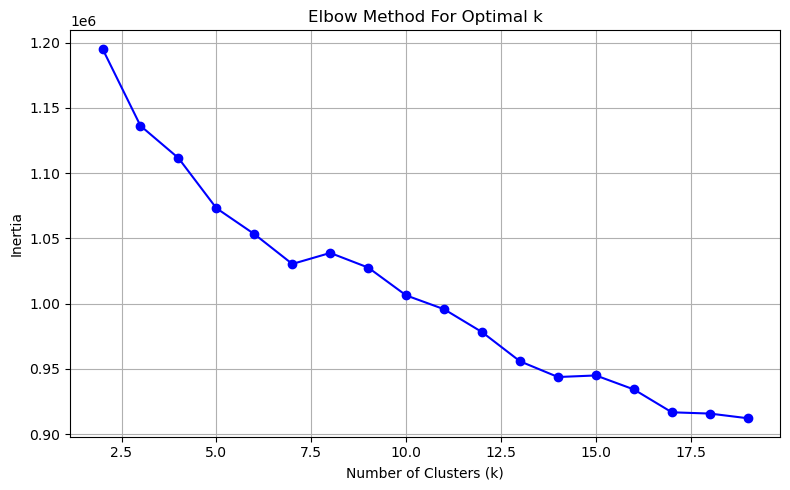

In [164]:
# Plot the elbow curve
plt.figure(figsize=(8, 5))
plt.plot(cluster_range_2, inertias_2, 'bo-')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia")
plt.title("Elbow Method For Optimal k")
plt.grid(True)
plt.tight_layout()
plt.show()

In [180]:
kmeans_basic_2 = KMeans(n_clusters=15, random_state=42)
cluster_labels_basic_2 = kmeans_basic_2.fit_predict(features_2)

In [181]:
df_2 = pd.DataFrame({
    "filename": filenames_2,
    "cluster": cluster_labels_basic_2
})
df_2.to_csv("../data/labels/cluster_results_basic_2.csv", index=False)

In [182]:
len(df_2.cluster.value_counts())

15

In [183]:
df_2["cluster"].value_counts().sort_index()

cluster
0     313
1     341
2     128
3      22
4     271
5     299
6     640
7     254
8     136
9     110
10    214
11    222
12    535
13    190
14    162
Name: count, dtype: int64

In [184]:
# Load the CSV
df_2 = pd.read_csv("../data/labels/cluster_results_basic_2.csv")

# Define the path to processed image tensors
processed_folder_2 = "../data/bad_clustered_images/"  # change this if needed

def show_cluster(df, cluster_id, num_images=16):
    # Filter filenames belonging to the selected cluster
    files = df[df['cluster'] == cluster_id]['filename'].values[:num_images]

    # Load the tensors and stack
    images = [torch.load(os.path.join(processed_folder_2, f)).unsqueeze(0) for f in files]
    images = torch.cat(images)

    # Denormalize from [-1, 1] to [0, 1] for display
    images = (images + 1) / 2

    # Create a grid and show
    grid = make_grid(images, nrow=10, padding=2)
    plt.figure(figsize=(40, 60))
    plt.imshow(grid.permute(1, 2, 0).numpy())
    plt.axis("off")
    plt.title(f"Cluster {cluster_id}")
    plt.show()

**Comments**
- K-means clustering is not working for the rest of the images.
- I should try DBSCAN now for these images.

## DBSCAN

In [201]:
resnet_3 = models.resnet18(pretrained=True)
resnet_3.fc = torch.nn.Identity()
resnet_3.eval()

features_list_3 = []
filenames_3 = []

with torch.no_grad():
    for batch, names in dataloader_2:
        batch_features_3 = resnet_3(batch)  # Shape: [B, 512]
        features_list_3.append(batch_features_3)
        filenames_3.extend(names)

features_3 = torch.cat(features_list_3)  # Shape: [N, 512]

/usr/lib/python3.13/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/lib/python3.13/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [192]:
from sklearn.cluster import DBSCAN

In [279]:
dbscan = DBSCAN(eps=0.5, min_samples=10)

In [280]:
features_3.shape # 2048 dimensional space

torch.Size([3837, 512])

In [281]:
dbscan.fit(features_3.numpy())

DBSCAN(min_samples=10)

In [282]:
dbscan.labels_

array([ -1,  -1,  -1, ..., 212,  -1, 175], shape=(3837,))

In [283]:
np.unique(dbscan.labels_)

array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
        12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
        25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,
        38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,
        51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,
        64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,
        77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
        90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102,
       103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115,
       116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128,
       129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
       142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
       155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167,
       168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 17

In [284]:
len(dbscan.core_sample_indices_)

2260

In [285]:
df_labels = pd.DataFrame({"label": dbscan.labels_})
print(df_labels['label'].value_counts().sort_index())

label
-1      1577
 0        11
 1        11
 2        11
 3        10
        ... 
 209      11
 210      10
 211      10
 212      10
 213      10
Name: count, Length: 215, dtype: int64


In [293]:
# Set this to your processed folder
processed_folder = "../data/bad_clustered_images/"

def show_dbscan_cluster(labels, filenames, cluster_id, num_images=16):
    # Find indices of images in the selected cluster
    indices = [i for i, label in enumerate(labels) if label == cluster_id]
    selected = np.random.choice(indices, min(num_images, len(indices)), replace=False)

    # Load tensors
    images = [torch.load(os.path.join(processed_folder, filenames_3[i])).unsqueeze(0) for i in selected]
    images = torch.cat(images)

    # Denormalize from [-1, 1] to [0, 1]
    images = (images + 1) / 2

    # Print filenames
    print(f"\nFilenames in DBSCAN Cluster {cluster_id}:")
    for idx in selected:
        print(filenames[idx])

    # Create and show grid
    grid = make_grid(images, nrow=4, padding=2)
    plt.figure(figsize=(8, 8))
    plt.imshow(grid.permute(1, 2, 0).numpy())
    plt.axis("off")
    plt.title(f"DBSCAN Cluster {cluster_id}")
    plt.show()


Filenames in DBSCAN Cluster 0:
bigs9g4s.pt
1fxkbn6a.pt
wsfepxfo.pt
2hjqtsnm.pt
j848j0bx.pt
bk95m0v1.pt
1iz1fytw.pt
0bty378h.pt
5ox97k47.pt
cpihotln.pt
xk83gm90.pt


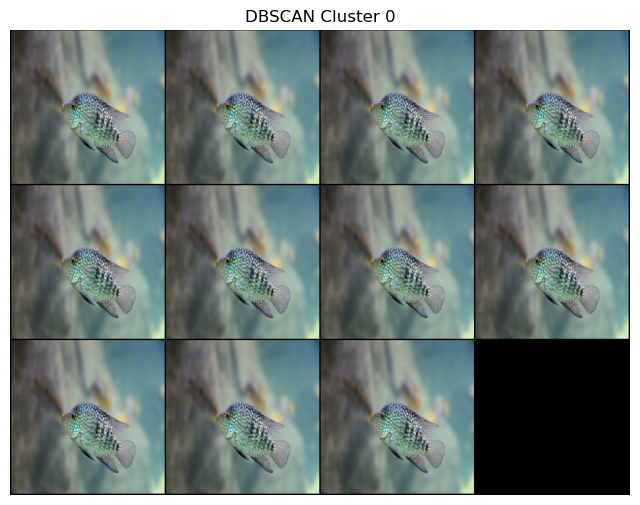


Filenames in DBSCAN Cluster 1:
o6d4xctj.pt
9uqz8oqt.pt
59ersnyd.pt
0ehebb4o.pt
3lftacc3.pt
xs3jseqw.pt
8wm1objo.pt
h4ka7j09.pt
nwcrlv69.pt
45fztd5f.pt
qkm7pq4s.pt


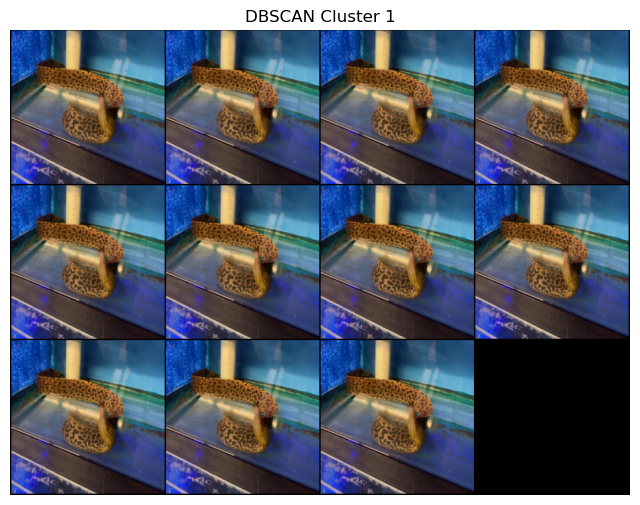

In [308]:
# Visualize a specific cluster (e.g., cluster 2)
for i in range(2):
    show_dbscan_cluster(dbscan.labels_, filenames_3, cluster_id=i, num_images=20)

In [264]:
filenames_3

['tc2az9x7.pt',
 '7tdmueel.pt',
 'j9fit435.pt',
 '0hos3gsw.pt',
 'uhg0cwsk.pt',
 '5ox97k47.pt',
 'xecmxh0n.pt',
 '59ersnyd.pt',
 'x1hnq5r4.pt',
 'lfps8ary.pt',
 'gu4uury8.pt',
 '3cvcspmn.pt',
 'q0pau56z.pt',
 '3ez6txig.pt',
 'l79bmv5s.pt',
 'tun5wqvi.pt',
 'hqkt95rn.pt',
 'iynznfv4.pt',
 'df0cp2fo.pt',
 'yuv8u2ge.pt',
 '3wtoredg.pt',
 'nl7csjzz.pt',
 'd7yfoq09.pt',
 '71gyf7hl.pt',
 'nssnm8db.pt',
 '84v5ac7g.pt',
 '9vkxp70m.pt',
 '64i83hgb.pt',
 'jfrmu2h7.pt',
 '4j01fjub.pt',
 '14bgb35q.pt',
 '89tvlvdl.pt',
 'vkav0j7t.pt',
 'vz3ze0vi.pt',
 'klola8cx.pt',
 'gy913rq2.pt',
 '3i9oc3sy.pt',
 '0tbvt9uv.pt',
 'v9wqdnpz.pt',
 'rbzju4fd.pt',
 '40vu78t9.pt',
 'owhib93o.pt',
 'x9v9iidj.pt',
 'lfzxa28q.pt',
 '5zo9v2bl.pt',
 '4wnoot1z.pt',
 'nw2dznu0.pt',
 'lgbjgav6.pt',
 'ho342f4f.pt',
 'xvd15wit.pt',
 'bmnbhf7i.pt',
 'qmfome6e.pt',
 'jq3g12fj.pt',
 'iz7j7hj5.pt',
 'y7kh4dq7.pt',
 'zelsx366.pt',
 'qtgjud90.pt',
 'xrel9dry.pt',
 'w2lpuws4.pt',
 '6nqwl5ps.pt',
 '5078tfoe.pt',
 'h9hf9790.pt',
 'nkg1ea

# Manually label the clusters into the categories

- The categories are:
    - anglerfish
    - corals
    - dolphine_whale
    - fish
    - jellyfish
    - lobster_crab
    - other_fish
    - rays
    - sea_angel
    - sea_horse
    - seal
    - shark
    - starfish_octopus
    - turtle

- They should be in the `data/clustered_images` folder.    

In [ ]:
# Folder where .pt images are saved
processed_folder = "../data/bad_clustered_images/"

def show_and_save_cluster_from_list(labels, filenames_3, cluster_id, num_images=16):
    # Find indices of images in this cluster
    indices = [i for i, label in enumerate(labels) if label == cluster_id]
    if len(indices) == 0:
        print(f"No images found for cluster {cluster_id}")
        return

    # Random selection for display
    selected = np.random.choice(indices, min(num_images, len(indices)), replace=False)
    selected_files = [filenames_3[i] for i in selected]

    # Load and stack images
    images = [torch.load(os.path.join(processed_folder, fname)).unsqueeze(0) for fname in selected_files]
    images = torch.cat(images)
    images = (images + 1) / 2  # Denormalize

    # Show grid of images
    grid = make_grid(images, nrow=4, padding=2)
    plt.figure(figsize=(8, 8))
    plt.imshow(grid.permute(1, 2, 0).numpy())
    plt.axis("off")
    plt.title(f"DBSCAN Cluster {cluster_id}")
    plt.show()

    # Ask user for save folder
    save_folder = input(f"Enter a folder name to save all images from cluster {cluster_id}: ").strip()
    save_path = os.path.join("data/clustered_images/", save_folder)
    os.makedirs(save_path, exist_ok=True)

    # Copy all images from that cluster
    for i in indices:
        src = os.path.join(processed_folder, filenames_3[i])
        dst = os.path.join(save_path, filenames_3[i])
        shutil.copyfile(src, dst)

    print(f"✅ Saved {len(indices)} images from cluster {cluster_id} to {save_path}")

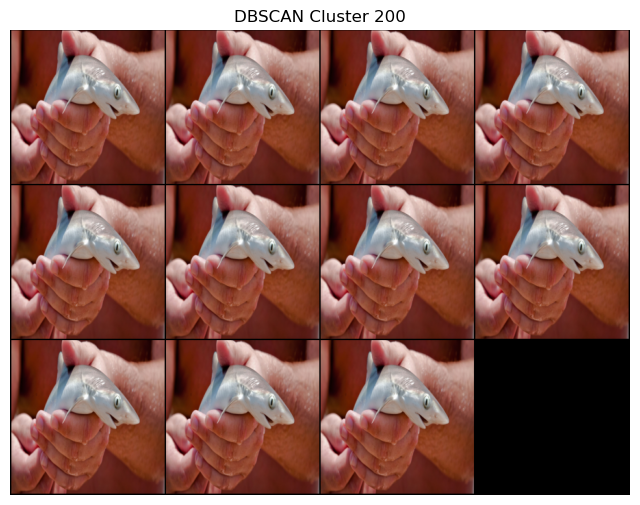

✅ Saved 11 images from cluster 200 to data/clustered_images_2/fish_72


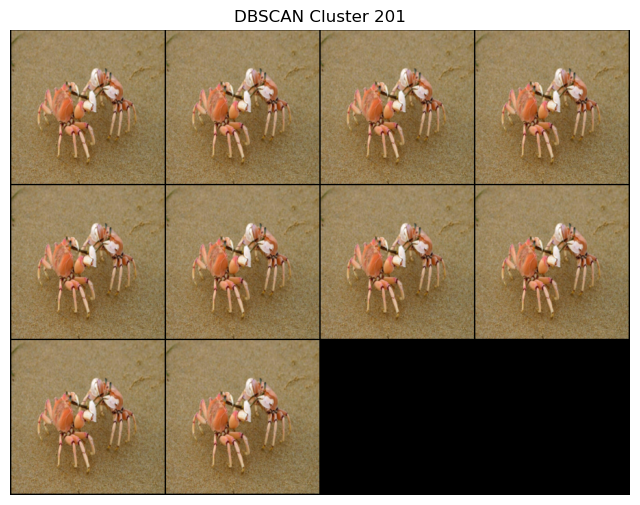

✅ Saved 10 images from cluster 201 to data/clustered_images_2/crabs


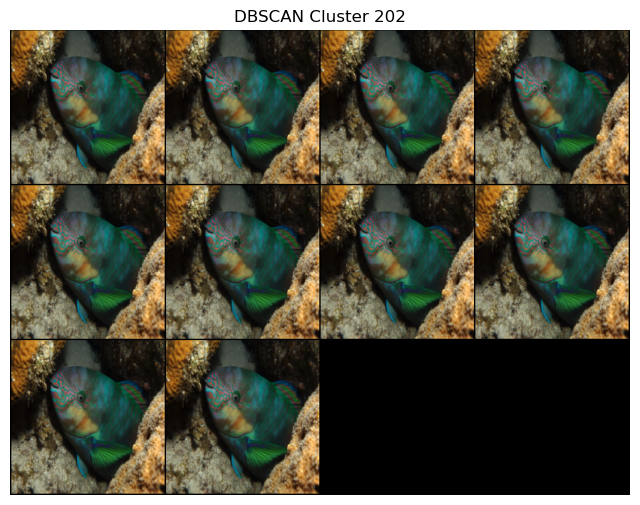

✅ Saved 10 images from cluster 202 to data/clustered_images_2/fish_73


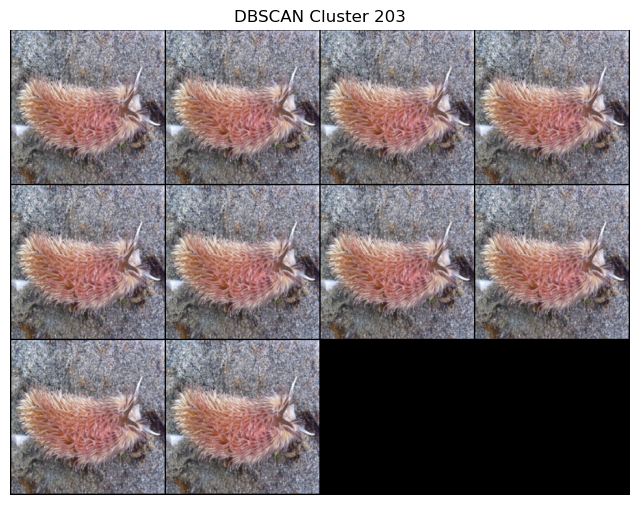

✅ Saved 10 images from cluster 203 to data/clustered_images_2/outlier


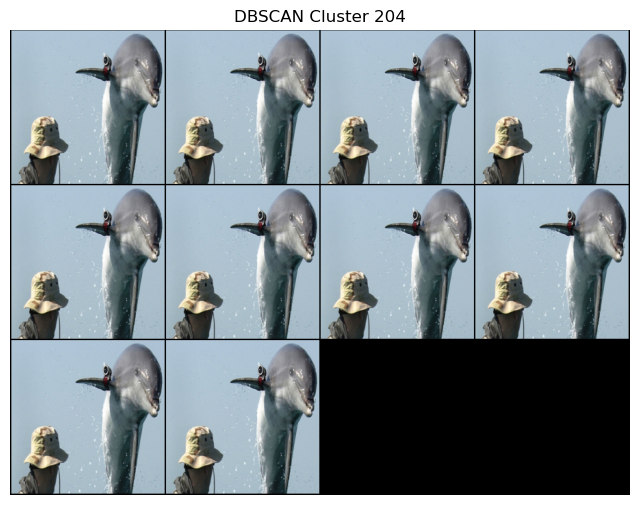

✅ Saved 10 images from cluster 204 to data/clustered_images_2/dolphin


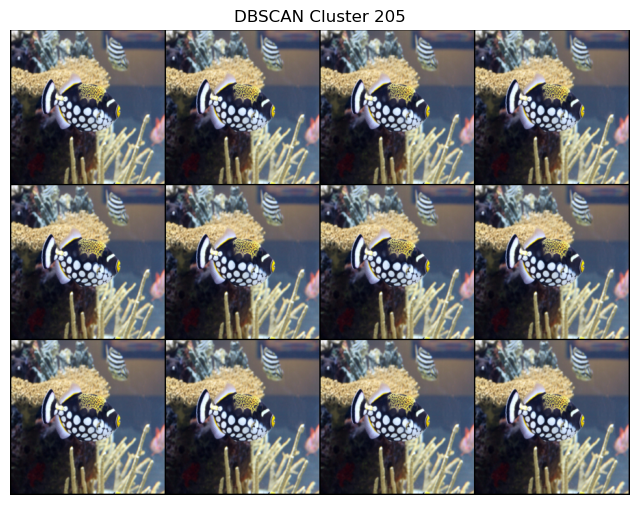

✅ Saved 12 images from cluster 205 to data/clustered_images_2/outlier


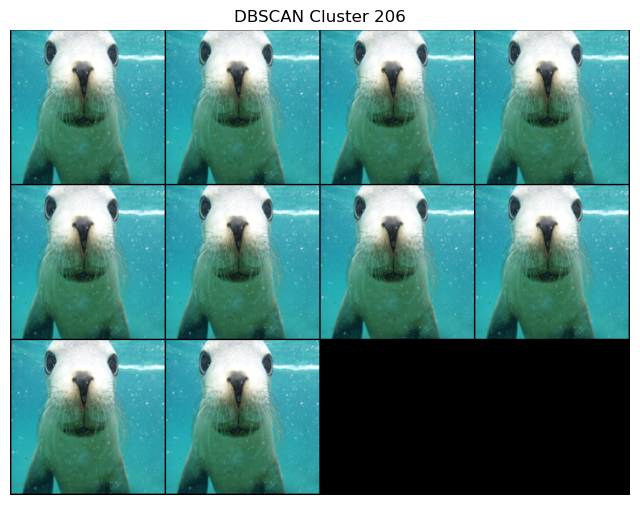

✅ Saved 10 images from cluster 206 to data/clustered_images_2/seal


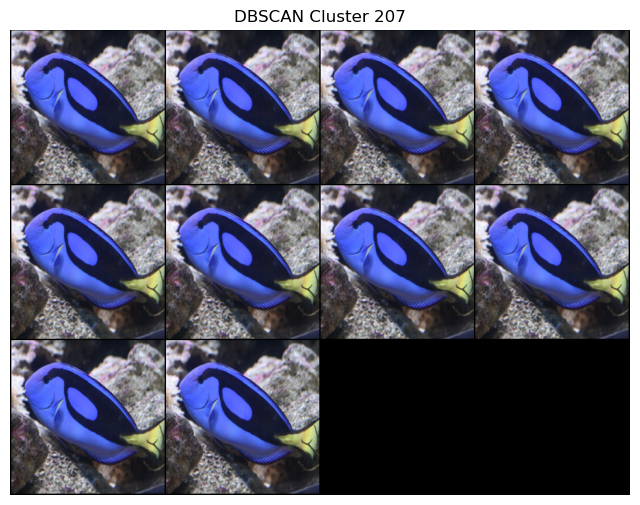

✅ Saved 10 images from cluster 207 to data/clustered_images_2/fish_74


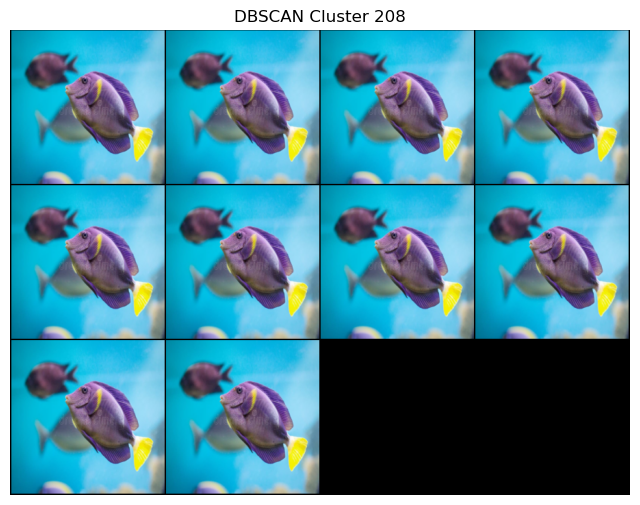

✅ Saved 10 images from cluster 208 to data/clustered_images_2/fish_75


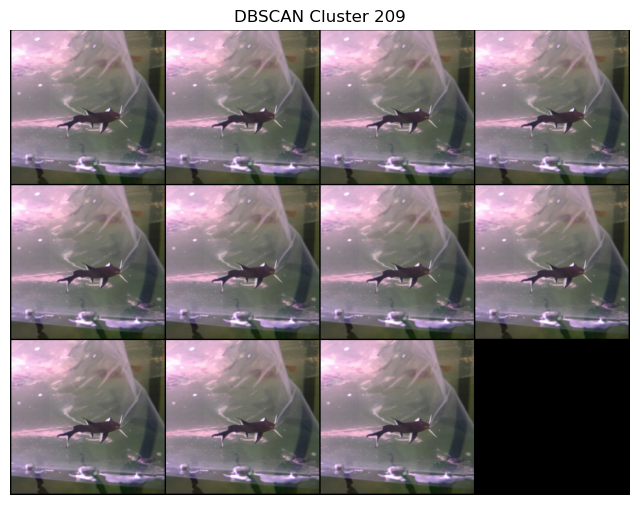

✅ Saved 11 images from cluster 209 to data/clustered_images_2/shark


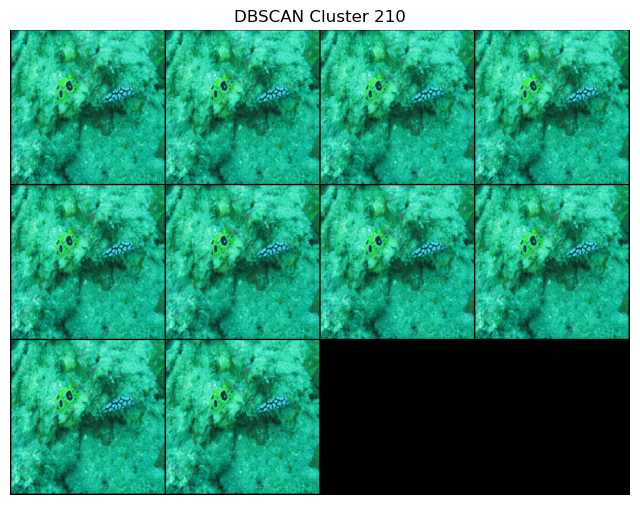

✅ Saved 10 images from cluster 210 to data/clustered_images_2/outlier


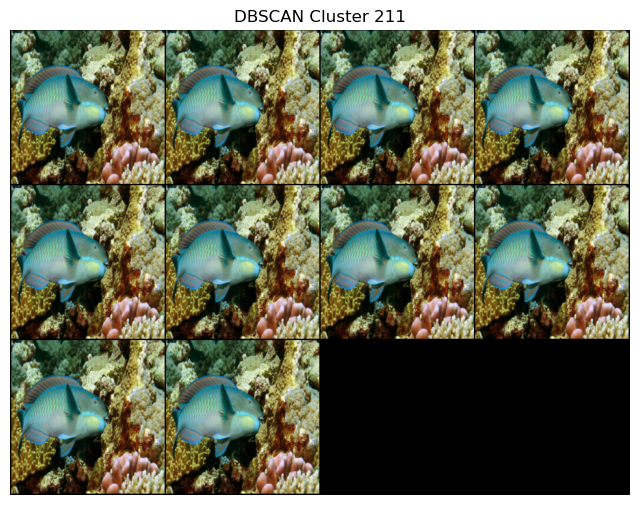

✅ Saved 10 images from cluster 211 to data/clustered_images_2/fish_76


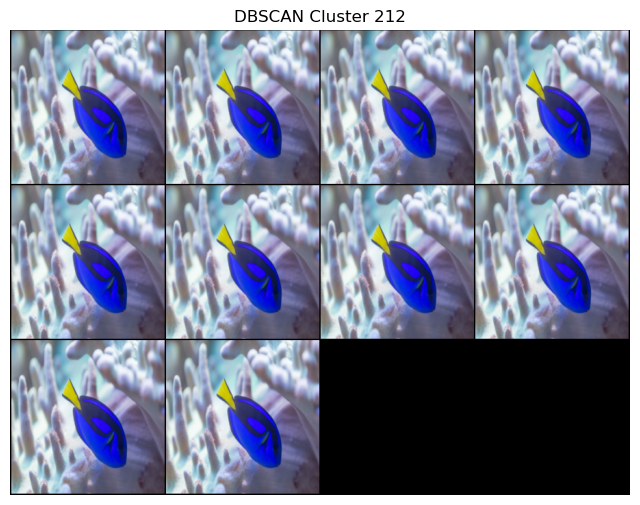

✅ Saved 10 images from cluster 212 to data/clustered_images_2/fish_77


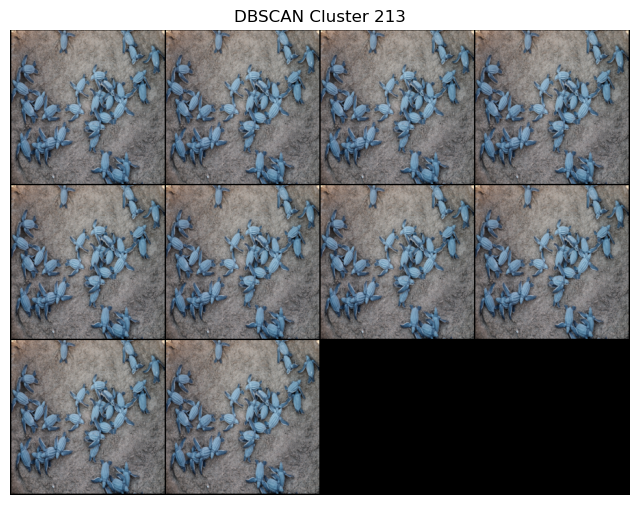

✅ Saved 10 images from cluster 213 to data/clustered_images_2/turtle


In [317]:
labels = dbscan.labels_
for i in range(200, 214):
    show_and_save_cluster_from_list(labels, filenames_3, cluster_id=i)